### EDA & Benchmark results

In [87]:
import os 
import torch

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from dataset import rescale
from skimage.transform import resize
from skimage import io
from net import ResUnet


In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [14]:
model_bce = ResUnet(1, 1)
model_bce.load_state_dict(torch.load('results/bce/model_checkpoint.pt'))
model_bce.to(device)

model_dmt = ResUnet(1, 1)
model_dmt.load_state_dict(torch.load('results/dmt/model_checkpoint.pt'))
model_dmt.to(device)

In [21]:
def np2torch(img):
    img_x = torch.Tensor(img)
    img_x = torch.unsqueeze(img_x, 0)
    return img_x

def torch2np(img_x):
    return img_x.detach().cpu().numpy().squeeze()

In [22]:
val_imgs = [resize(rescale(io.imread(os.path.join('data/val_frames/', f))), (256, 256)) 
            for f in sorted(os.listdir('data/val_frames/'))]

val_masks = [(resize(rescale(io.imread(os.path.join('data/val_masks/', f))), (256, 256)) > 0.5).astype(np.uint8) 
             for f in sorted(os.listdir('data/val_masks/'))]

In [43]:
val_preds_bce = []
val_preds_dmt = []

for img in zip(val_imgs):
    x = np2torch(img)
    x = x.to(device)
    y1 = model_bce(x)
    y2 = model_dmt(x)
    
    y_pred_bce = torch2np(y1)
    y_pred_bce = (y_pred_bce > 0.5).astype(np.uint8)
    y_pred_dmt = torch2np(y2)
    y_pred_dmt = (y_pred_dmt > 0.5).astype(np.uint8)
    
    val_preds_bce.append(y_pred_bce)
    val_preds_dmt.append(y_pred_dmt)

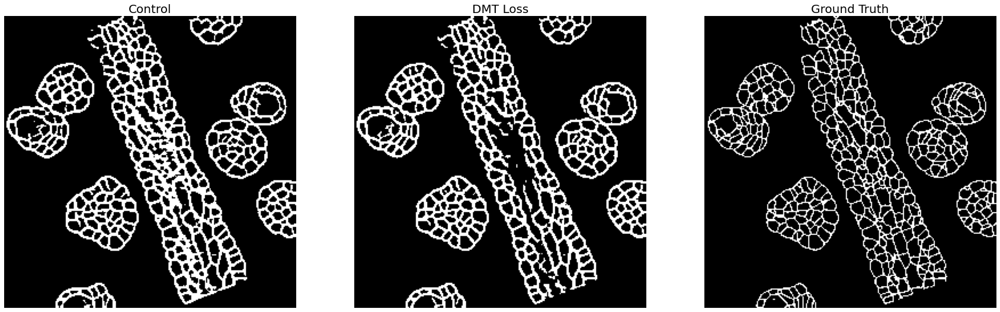

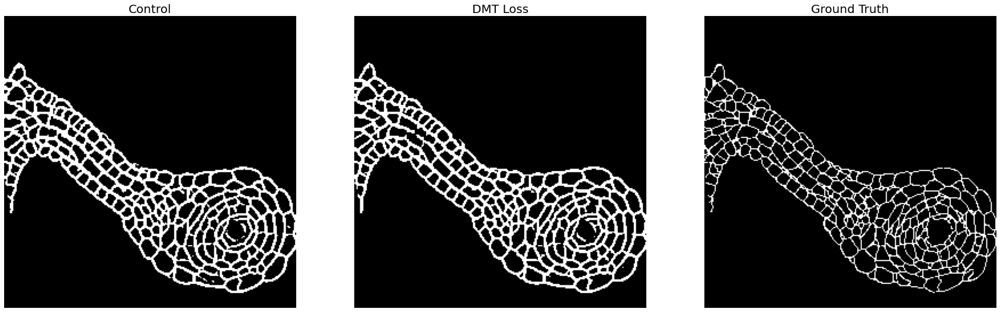

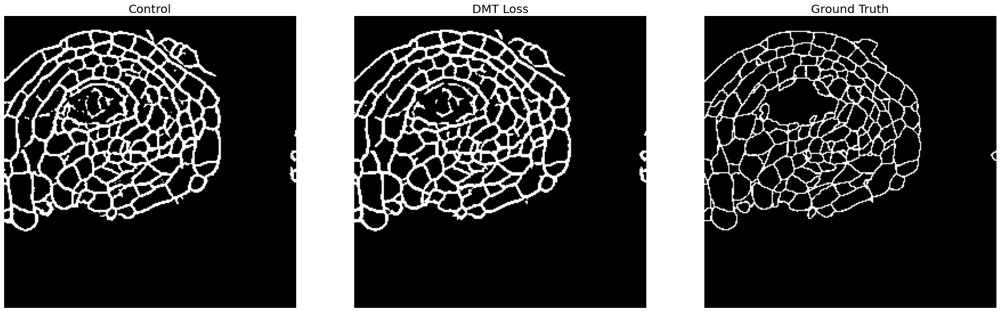

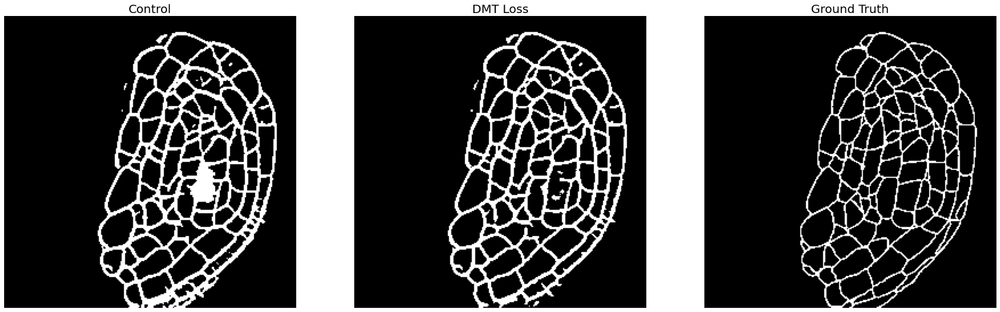

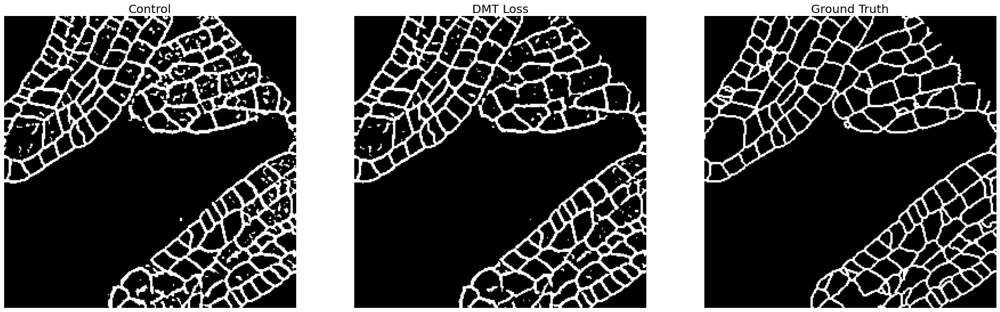

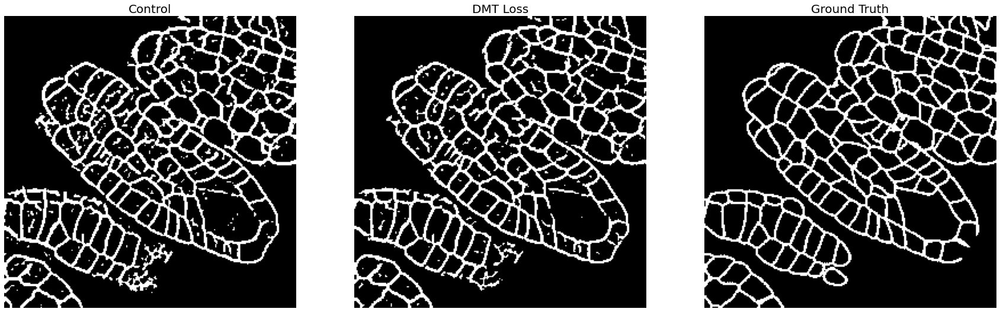

In [44]:
for mask, pred_bce, pred_dmt in zip(val_masks, val_preds_bce, val_preds_dmt):
    fig, axes = plt.subplots(1, 3, figsize=(30, 10))
    axes[0].imshow(pred_bce, cmap='gray')
    axes[0].axis('off')
    axes[0].set_title('Control', fontsize=20)
    
    axes[1].imshow(pred_dmt, cmap='gray')
    axes[1].axis('off')
    axes[1].set_title('DMT Loss', fontsize=20)
    
    axes[2].imshow(mask, cmap='gray')
    axes[2].axis('off')
    axes[2].set_title('Ground Truth', fontsize=20)
    
    plt.show()

In [115]:
def plot_img_3d_distribution(img, figsize=(10, 12)):
    """
    Plot 3D value distribution of the given image
    """
    height, width = img.shape

    img_vals = np.zeros((height * width, 3))
    img_vals[:, 0] = np.repeat(np.arange(height), width)
    img_vals[:, 1] = np.tile(np.arange(width), height)
    img_vals[:, 2] = img.flatten()

    df = pd.DataFrame(img_vals, columns=['X', 'Y', 'Z'])

    fig = plt.figure(figsize=figsize)
    ax = fig.gca(projection='3d')
    q = ax.plot_trisurf(df['Y'], df['X'], df['Z'], cmap=plt.cm.seismic, linewidth=0.1)
    
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.set_title('Membrane staining intensity', fontsize=15)
    
    ax.view_init(60, 60)
    fig.colorbar(q, label="Z")

    plt.show()
    fig.savefig('results/contour.png', dpi=300)
    plt.close()

/tmp/ipykernel_395648/1208821607.py:15: MatplotlibDeprecationWarning: Calling gca() with keyword arguments was deprecated in Matplotlib 3.4. Starting two minor releases later, gca() will take no keyword arguments. The gca() function should only be used to get the current axes, or if no axes exist, create new axes with default keyword arguments. To create a new axes with non-default arguments, use plt.axes() or plt.subplot().
  ax = fig.gca(projection='3d')


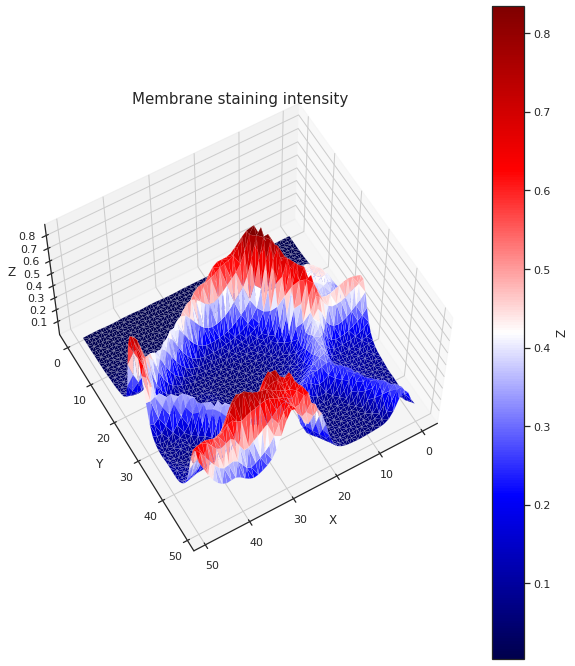

In [116]:
plot_img_3d_distribution(test_img[:50, 130:180])

In [49]:
from utils import calc_acc, calc_f1, calc_mse, calc_hausdorff
from skimage.metrics import variation_of_information as voi

Control results

In [47]:
print(calc_acc(val_masks, val_preds_bce))
print(calc_f1(val_masks, val_preds_bce))
print(calc_mse(np.array(val_masks), np.array(val_preds_bce)))
print(calc_hausdorff(np.array(val_masks), np.array(val_preds_bce)))

0.9023717244466146
0.910601076947934
126.16666666666667
12.900244171337794


In [55]:
v0s_bce = []
v1s_bce = []

for pred_bce, mask in zip(val_preds_bce, val_masks):
    v0, v1 = voi(pred_bce, mask)
    v0s_bce.append(v0)
    v1s_bce.append(v1)
    
    
print("VOI_split:", np.mean(v0s_bce), "VOI_merge:", np.mean(v1s_bce))

VOI_split: 0.2998999217910772 VOI_merge: 0.4512411097875257


DMT results

In [48]:
print(calc_acc(val_masks, val_preds_dmt))
print(calc_f1(val_masks, val_preds_dmt))
print(calc_mse(np.array(val_masks), np.array(val_preds_dmt)))
print(calc_hausdorff(np.array(val_masks), np.array(val_preds_dmt)))

0.9077123006184896
0.914428853992531
117.5
12.988164353527294


In [56]:
v0s_dmt = []
v1s_dmt = []

for pred_dmt, mask in zip(val_preds_dmt, val_masks):
    v0, v1 = voi(pred_dmt, mask)
    v0s_dmt.append(v0)
    v1s_dmt.append(v1)
    
    
print("VOI_split:", np.mean(v0s_dmt), "VOI_merge:", np.mean(v1s_dmt))

VOI_split: 0.3015006485862411 VOI_merge: 0.4291655703662339


Application on MIBI-ToF

In [119]:
mibi_imgs = [resize(rescale(io.imread(os.path.join('data/test/', f))), (256, 256)) 
             for f in sorted(os.listdir('data/test/'))]

In [126]:
mibi_preds_bce = []
mibi_preds_dmt = []

for img in zip(mibi_imgs):
    x = np2torch(img)
    x = x.to(device)
    y1 = model_bce(x)
    y2 = model_dmt(x)
    
    y_pred_bce = torch2np(y1)
    y_pred_bce = (y_pred_bce > 0.5).astype(np.uint8)
    y_pred_dmt = torch2np(y2)
    y_pred_dmt = (y_pred_dmt > 0.5).astype(np.uint8)
    
    mibi_preds_bce.append(y_pred_bce)
    mibi_preds_dmt.append(y_pred_dmt)

In [134]:
mibi_pred_bce_p1 = np.zeros((1024, 1024))
mibi_pred_dmt_p1 = np.zeros_like(mibi_pred_bce_p1)

mibi_pred_bce_p5 = np.zeros((1024, 1024))
mibi_pred_dmt_p5 = np.zeros_like(mibi_pred_bce_p5)

xpos = 0
ypos = 0

for i, (pred_bce1, pred_dmt1, pred_bce5, pred_dmt5) in enumerate(zip(mibi_preds_bce[:16], mibi_preds_dmt[:16], mibi_preds_bce[16:], mibi_preds_dmt[16:])):
    mibi_pred_bce_p1[xpos:xpos+256, ypos:ypos+256] = pred_bce1
    mibi_pred_dmt_p1[xpos:xpos+256, ypos:ypos+256] = pred_dmt1
    mibi_pred_bce_p5[xpos:xpos+256, ypos:ypos+256] = pred_bce5
    mibi_pred_dmt_p5[xpos:xpos+256, ypos:ypos+256] = pred_dmt5
    ypos += 256
    
    if i % 4 == 3:
        xpos += 256
        ypos = 0

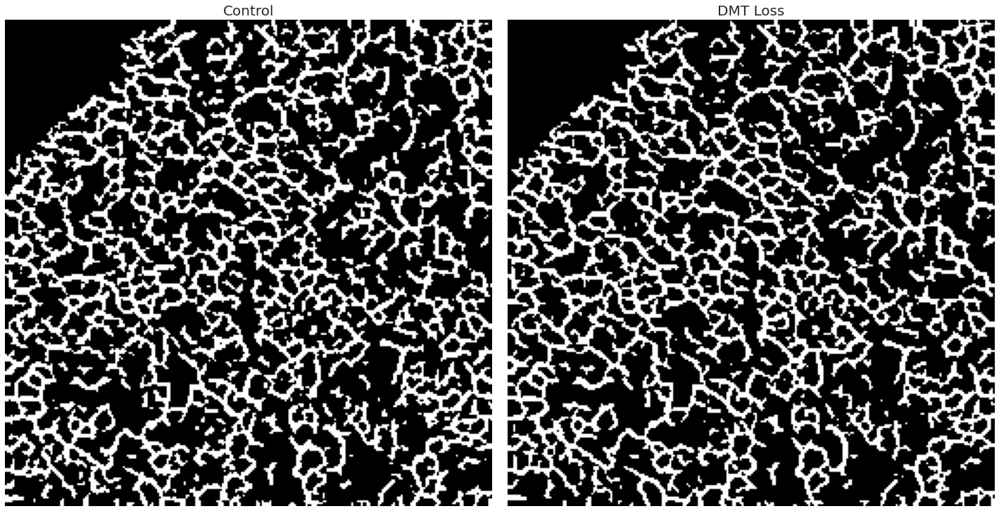

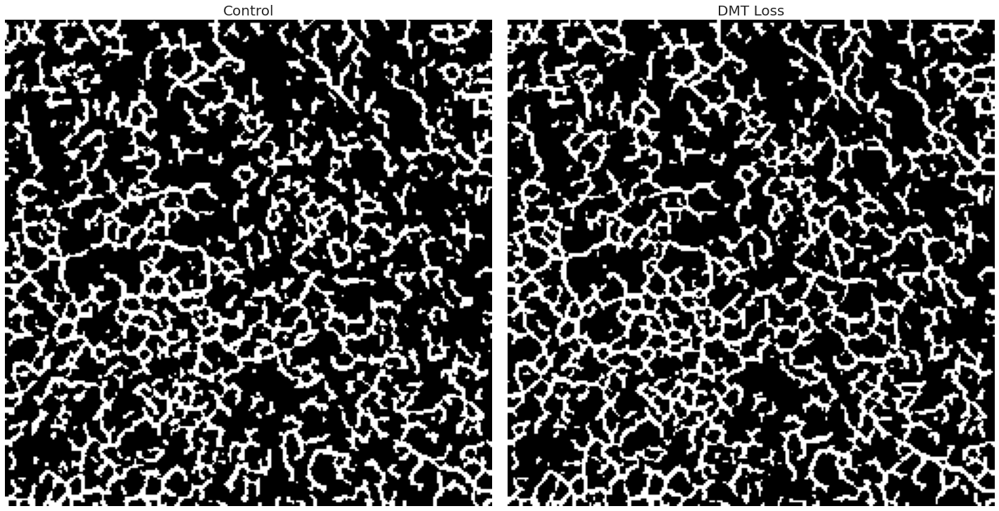

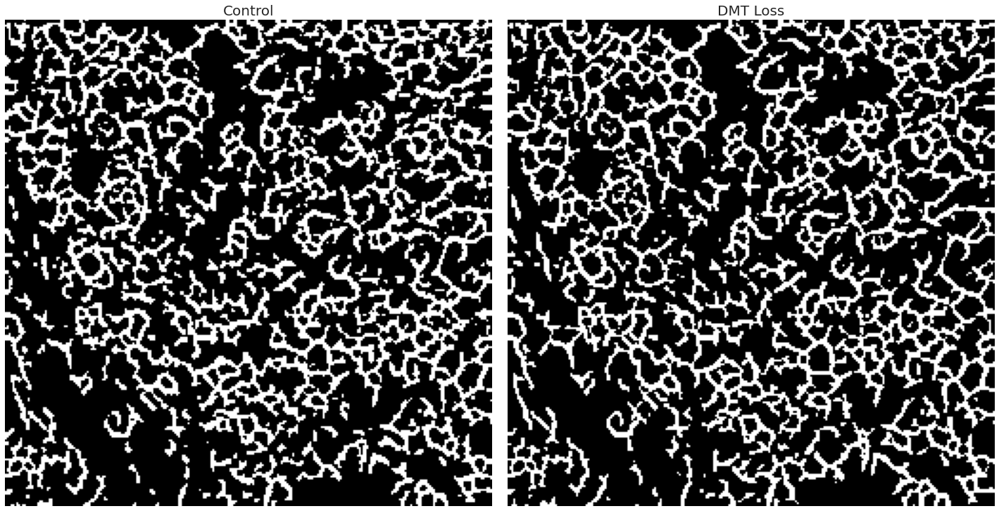

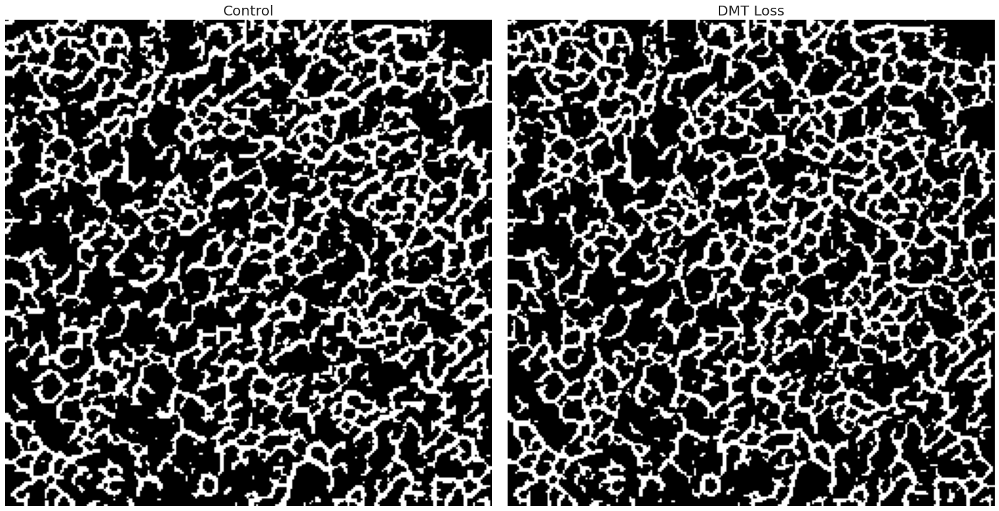

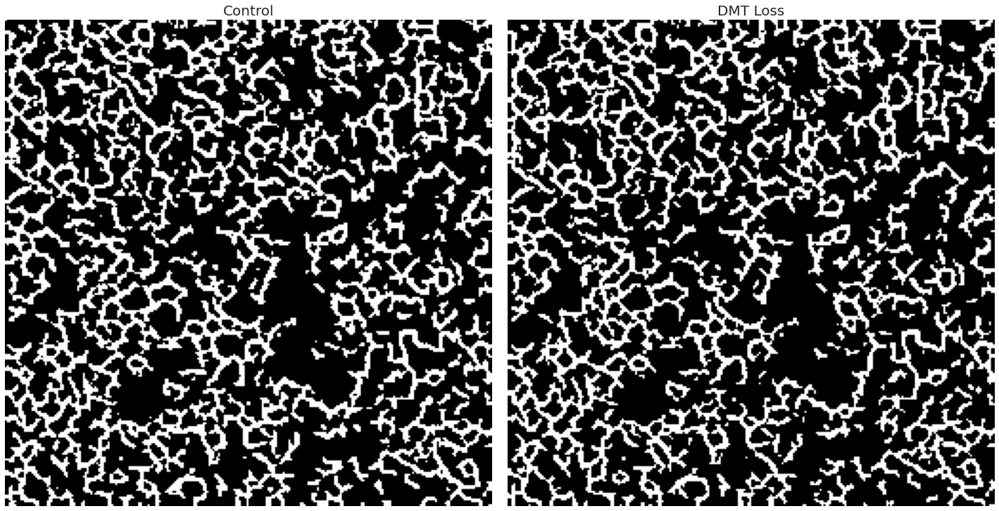

...

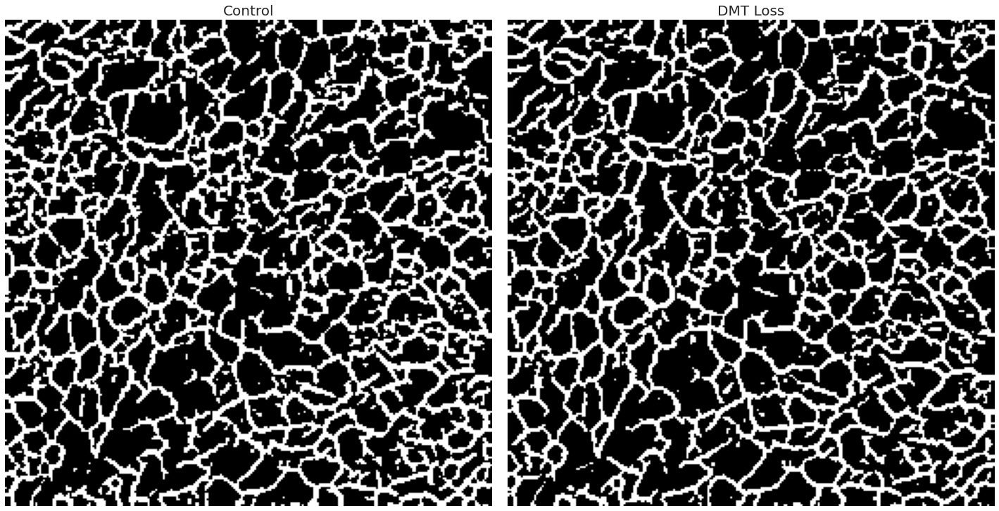

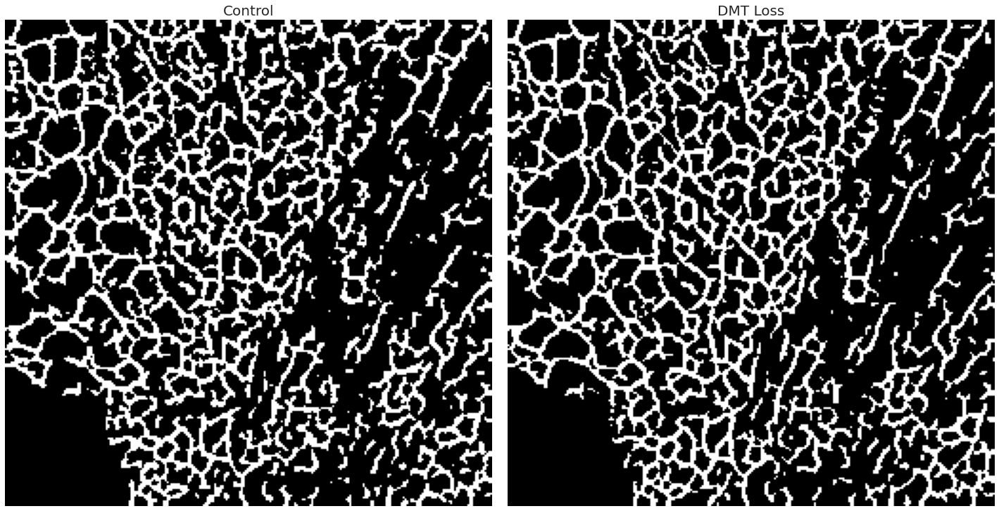

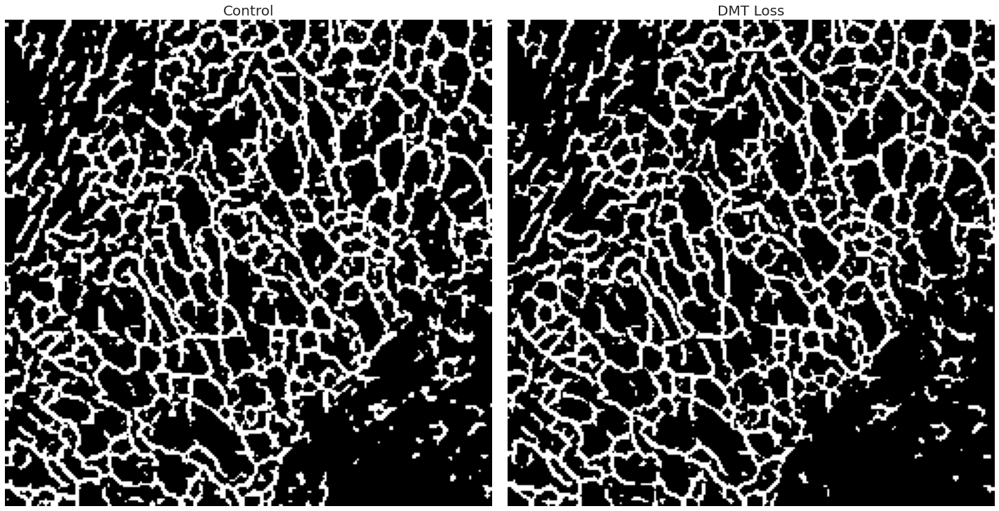

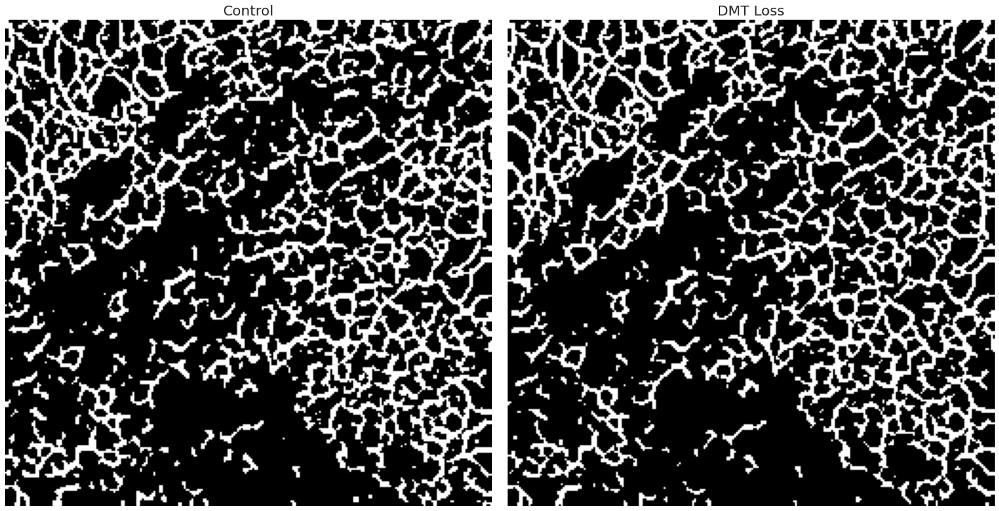

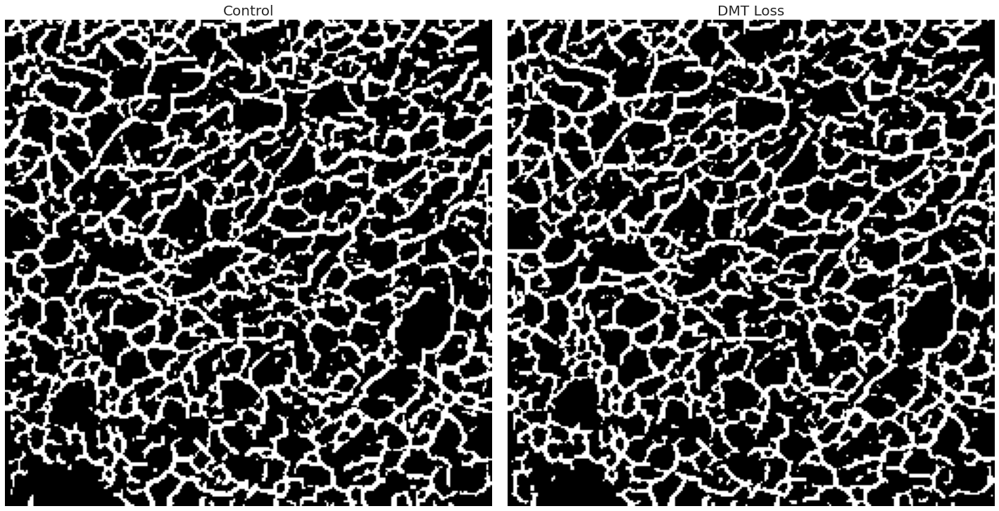

In [137]:
for pred_bce, pred_dmt in zip(mibi_preds_bce, mibi_preds_dmt):
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))
    axes[0].imshow(pred_bce, cmap='gray')
    axes[0].axis('off')
    axes[0].set_title('Control', fontsize=20)

    axes[1].imshow(pred_dmt, cmap='gray')
    axes[1].axis('off')
    axes[1].set_title('DMT Loss', fontsize=20)

    plt.tight_layout()
    plt.show()

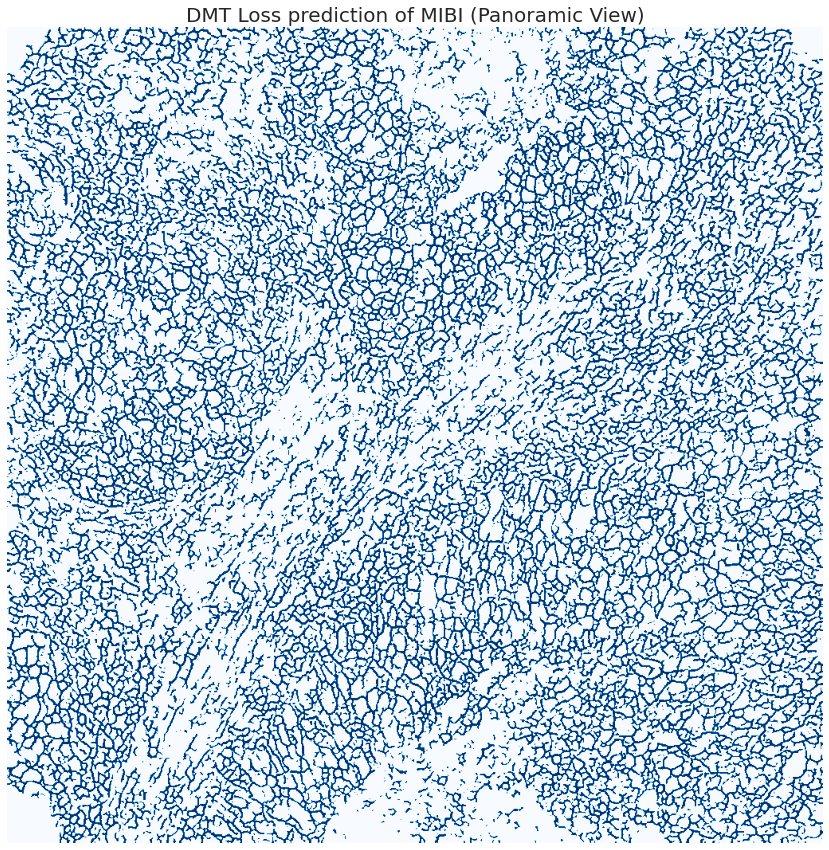

In [144]:
plt.figure(figsize=(15, 15))
plt.imshow(mibi_pred_dmt_p5, cmap='Blues')
plt.axis('off') 
plt.title('DMT Loss prediction of MIBI (Panoramic View)', fontsize=20)
plt.savefig('results/mibi.png', dpi=300)

---